<a href="https://colab.research.google.com/github/AniLeo-01/Dogs-vs-Cats/blob/notebook/dogs_vs_cats.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Sun Apr 18 07:43:15 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#Connecting the GDrive

In [ ]:
from google.colab import drive 
drive.mount('/content/drive')


Mounted at /content/drive


#Importing the data and unzipping the contents

In [ ]:
import zipfile
zip_path1 = '/content/drive/MyDrive/Dogs-vs-cats dataset/test1.zip'
zip_ref = zipfile.ZipFile(zip_path1, 'r')
zip_ref.extractall("/content/")

In [ ]:
zip_path2 = '/content/drive/MyDrive/Dogs-vs-cats dataset/train.zip'
zip_ref = zipfile.ZipFile(zip_path2, 'r')
zip_ref.extractall("/content/")

In [ ]:
zip_ref.close()

#Creating the dataset

In [ ]:
#Training data
import os
import pandas as pd
directory = os.listdir('/content/train/')
class_name = []
names = []
for filename in directory:
  name = filename.split('.')[0] #selecting only the dog or cat
  if name=='dog':
    names.append(1)
    class_name.append('dog')
  else:
    names.append(0)
    class_name.append('cat')
#creating a dataframe
data = pd.DataFrame({
    'filename': directory,
    'class' : class_name,
    'category': names
})

In [ ]:
data.head()

,filename,class,category
0,cat.9591.jpg,cat,0
1,cat.6945.jpg,cat,0
2,cat.11982.jpg,cat,0
3,cat.1648.jpg,cat,0
4,dog.5732.jpg,dog,1


#Visualizing the data count and checking whether there are any class imbalance or not

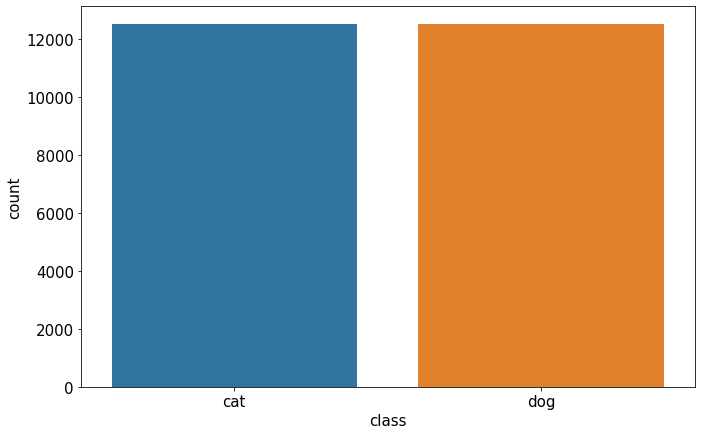

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=(11,7))
plt.rcParams.update({'font.size': 15})
sns.countplot(x='class', data = data)

#Visualizing a sample image

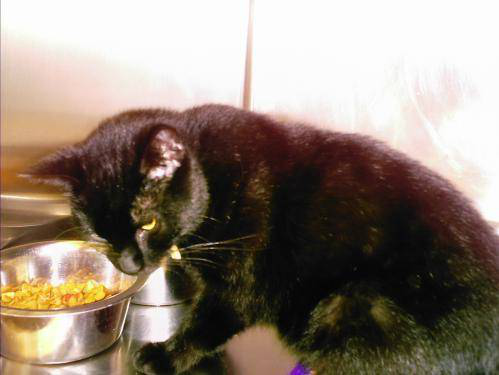

In [ ]:
#sample image
from PIL import Image
filepath = '/content/train/'
im = Image.open(filepath+data['filename'][101])
im

#model building

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.metrics import AUC

inputs = keras.Input(shape=(128,128,3), name = 'input')
x = layers.Conv2D(64, 3, activation='relu', padding='same')(inputs)
x = layers.Conv2D(64, 3, activation= 'relu', padding= 'same')(x)

batch_normalization = layers.BatchNormalization()(x)
maxpool = layers.MaxPooling2D(strides = (2,2))(batch_normalization)
dropout = layers.Dropout(0.05)(maxpool)

x = layers.Conv2D(128, 3, activation='relu', padding='same')(dropout)
x = layers.Conv2D(128, 3, activation= 'relu', padding= 'same')(x)

batch_normalization = layers.BatchNormalization()(x)
maxpool = layers.MaxPooling2D(strides = (2,2))(batch_normalization)
dropout = layers.Dropout(0.05)(maxpool)

x = layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(dropout)
x = layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(x)
x = layers.Conv2D(256, 3, activation = 'relu', padding = 'same')(x)

batch_normalization = layers.BatchNormalization()(x)
maxpool = layers.MaxPooling2D(strides = (2,2))(batch_normalization)
dropout = layers.Dropout(0.05)(maxpool)

x = layers.Conv2D(512, 3, activation = 'relu', padding= 'same')(dropout)
x = layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(x)
x = layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(x)

batch_normalization = layers.BatchNormalization()(x)
maxpool = layers.MaxPooling2D(strides = (2,2))(batch_normalization)
dropout = layers.Dropout(0.05)(maxpool)

x = layers.Conv2D(512, 3, activation = 'relu', padding= 'same')(dropout)
x = layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(x)
x = layers.Conv2D(512, 3, activation = 'relu', padding = 'same')(x)

batch_normalization = layers.BatchNormalization()(x)
maxpool = layers.MaxPooling2D(strides = (2,2))(batch_normalization)
flatten = layers.Flatten()(maxpool)

x = layers.Dense(4096, activation = 'relu')(flatten)
x = layers.Dense(4096, activation = 'relu')(x)
x = layers.Dense(1000, activation = 'relu')(x)

batch_normalization = layers.BatchNormalization()(x)
dropout = layers.Dropout(0.5)(batch_normalization)

outputs = layers.Dense(2, activation='softmax')(dropout)
model = keras.Model(inputs, outputs, name="VGG")
model.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy', AUC()])
model.summary()

Model: "VGG"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 128, 128, 64)      1792      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      36928     
_________________________________________________________________
batch_normalization (BatchNo (None, 128, 128, 64)      256       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 64, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856   

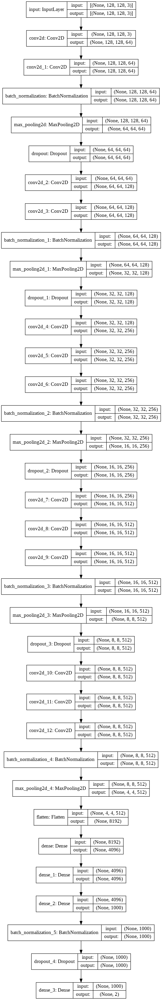

In [ ]:
keras.utils.plot_model(model, "test2.png", show_shapes=True)

#Defining the callbacks

In this case we are using ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, and Tensorboard

In [ ]:
#defining callbacks
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard
%load_ext tensorboard
import datetime
log_dir = "/content/logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

save_filepath = '/content/checkpoint/'
checkpoint = ModelCheckpoint(save_filepath, verbose=1, save_best_only=True, mode='auto')
early_stopper = EarlyStopping(patience=10, verbose=1, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(patience=2, factor=0.05, verbose=1, min_lr=0.0001)
tensorboard = TensorBoard(log_dir=log_dir, histogram_freq = 1, write_images = True)
callbacks = [checkpoint, early_stopper, reduce_lr, tensorboard]


#Splitting dataset into training and validation data

In [ ]:
#train validation and test split
from sklearn.model_selection import train_test_split
train_set, val_set = train_test_split(data, train_size=0.8)
train_set = train_set.reset_index(drop=True)
val_set = val_set.reset_index(drop=True)

#Visualization training data count

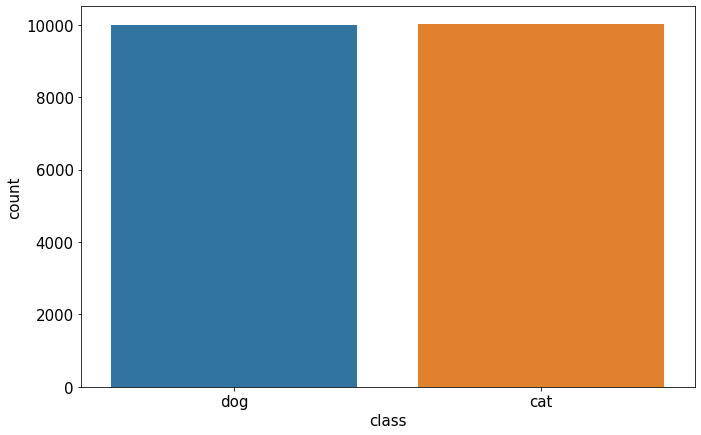

In [ ]:
plt.figure(figsize=(11,7))
plt.rcParams.update({'font.size': 15})
sns.countplot(x='class', data = train_set)

#Visualization validation data count

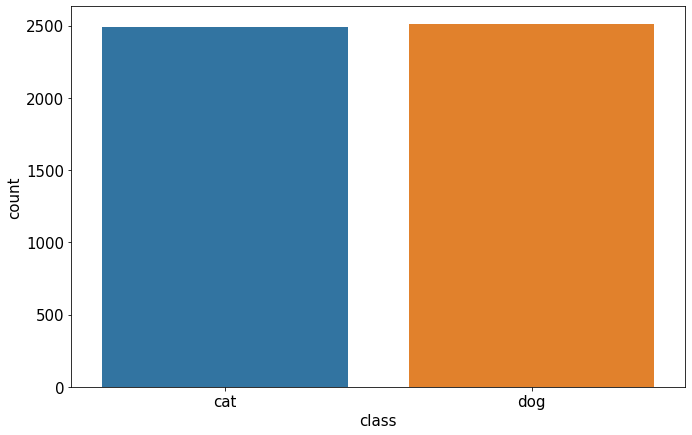

In [ ]:
plt.figure(figsize=(11,7))
plt.rcParams.update({'font.size': 15})
sns.countplot(x='class', data = val_set)

#Training Data Augmentation and creating the Training DataLoader

In [ ]:
#image Augmentation
from keras.preprocessing.image import ImageDataGenerator
train_dataloader = ImageDataGenerator(
    rescale = 1./255,
    rotation_range = 90,
    width_shift_range = 0.3,
    height_shift_range = 0.3,
    shear_range = 45,
    zoom_range = 0.3,
    horizontal_flip = True,
    vertical_flip = True
)

#training DataLoader
train_dataloader = train_dataloader.flow_from_dataframe(
    train_set,
    directory = filepath,
    x_col = 'filename',
    y_col = 'class',
    target_size = (128,128),
    classes = ['dog', 'cat'],
    class_mode = 'categorical',
    interpolation = 'lanczos'
)

Found 20000 validated image filenames belonging to 2 classes.


#Validation Data Augmentation and creating the Validation DataLoader

In [ ]:
#validation data augmentation
val_dataloader = ImageDataGenerator(rescale=1./255)

#validation DataLoader
val_dataloader = val_dataloader.flow_from_dataframe(
    val_set,
    directory = filepath,
    x_col = 'filename',
    y_col = 'class',
    target_size = (128,128),
    classes = ['dog', 'cat'],
    class_mode = 'categorical',
    interpolation = 'lanczos'
)

Found 5000 validated image filenames belonging to 2 classes.


#Training the model

In [ ]:
def train(model, epochs):
  epochs = 25
  batch_size = 15
  history = model.fit(
      train_dataloader,
      epochs = epochs,
      verbose = 1,
      callbacks = callbacks,
      validation_data = val_dataloader,
      use_multiprocessing = True,
      workers = -1
  )
  return history

##Training (1st half - 25 epochs)

In [ ]:
#model fit
history = train(model, 25)

model.save_weights("dogcat.h5")
model.save('/model/')

##Training (2nd half - 25 epochs)

In [ ]:
model.load_weights('/content/drive/MyDrive/Dogs-vs-cats dataset/dogcat.h5')
history = train(model, 25)
model.save_weights("dogcat.h5")


Epoch 1/25
625/625 [==============================] - 284s 454ms/step - loss: 0.8585 - accuracy: 0.5811 - auc: 0.6120 - val_loss: 0.6706 - val_accuracy: 0.6252 - val_auc: 0.6723

Epoch 00001: val_loss improved from 0.78664 to 0.67059, saving model to /content/checkpoint/
INFO:tensorflow:Assets written to: /content/checkpoint/assets
Epoch 2/25
625/625 [==============================] - 282s 452ms/step - loss: 0.8683 - accuracy: 0.5742 - auc: 0.6044 - val_loss: 0.6730 - val_accuracy: 0.6214 - val_auc: 0.6699

Epoch 00002: val_loss did not improve from 0.67059
Epoch 3/25
625/625 [==============================] - 281s 450ms/step - loss: 0.8692 - accuracy: 0.5705 - auc: 0.6004 - val_loss: 0.6707 - val_accuracy: 0.6238 - val_auc: 0.6710

Epoch 00003: val_loss did not improve from 0.67059
Epoch 4/25
625/625 [==============================] - 281s 450ms/step - loss: 0.8717 - accuracy: 0.5786 - auc: 0.6039 - val_loss: 0.6699 - val_accuracy: 0.6210 - val_auc: 0.6713

Epoch 00004: val_loss impro

In [ ]:
%tensorboard --logdir logs/fit

INFO:tensorflow:Assets written to: /model/assets


<IPython.core.display.Javascript object>

In [ ]:
model.save_weights('dogcat.h5')

#Creating Test Dataset

In [ ]:
import os
import pandas as pd

test_dir = os.listdir('/content/test1/')
test_set = pd.DataFrame({
    'filenames' : test_dir
})

#Test set Image Augmentation and DataLoader

In [ ]:
test_set.head()

,filenames
0,3392.jpg
1,1568.jpg
2,2166.jpg
3,231.jpg
4,4698.jpg


In [ ]:
test_dataloader = ImageDataGenerator(rescale=1./255)

test_dataloader = test_dataloader.flow_from_dataframe(
    test_set,
    '/content/test1/',
    x_col='filenames',
    y_col= None,
    class_mode=None,
    target_size=(128,128),
    batch_size=15,
    shuffle = False
)



Found 12500 validated image filenames.


#Prediction

In [ ]:
predictions = model.predict(test_dataloader)

##Creating a test dataset

In [ ]:
import numpy as np
test_set['category']=np.argmax(predictions, axis=-1)

In [ ]:
test_set.head()

,filenames,category
0,3392.jpg,1
1,1568.jpg,1
2,2166.jpg,1
3,231.jpg,1
4,4698.jpg,1


In [ ]:
label_map = dict((v,k) for k,v in train_dataloader.class_indices.items())
test_set['category'] = test_set['category'].replace(label_map)


In [ ]:
test_set['class'] = test_set['category']
test_set['class'] = test_set['class'].replace({'dog' : 1, 'cat' : 0})

In [ ]:
test_set.head()

,filenames,category,class
0,3392.jpg,dog,1
1,1568.jpg,dog,1
2,2166.jpg,dog,1
3,231.jpg,dog,1
4,4698.jpg,dog,1


#Visualizing class count

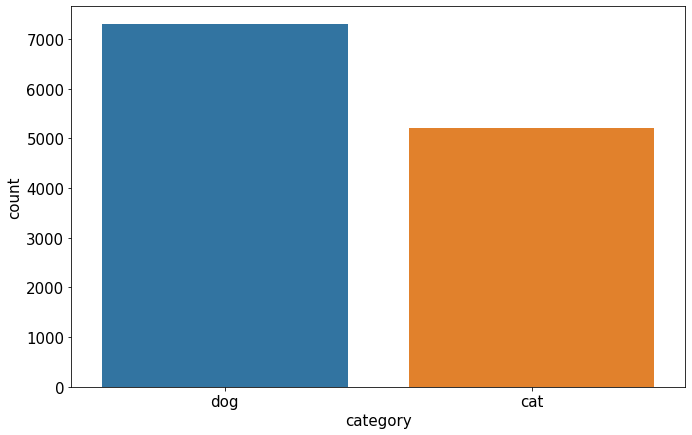

In [ ]:
plt.figure(figsize=(11,7))
plt.rcParams.update({'font.size': 15})
sns.countplot(x='category', data = test_set)

#Visualizing output predictions 

1 : Dogs

0 : Cats

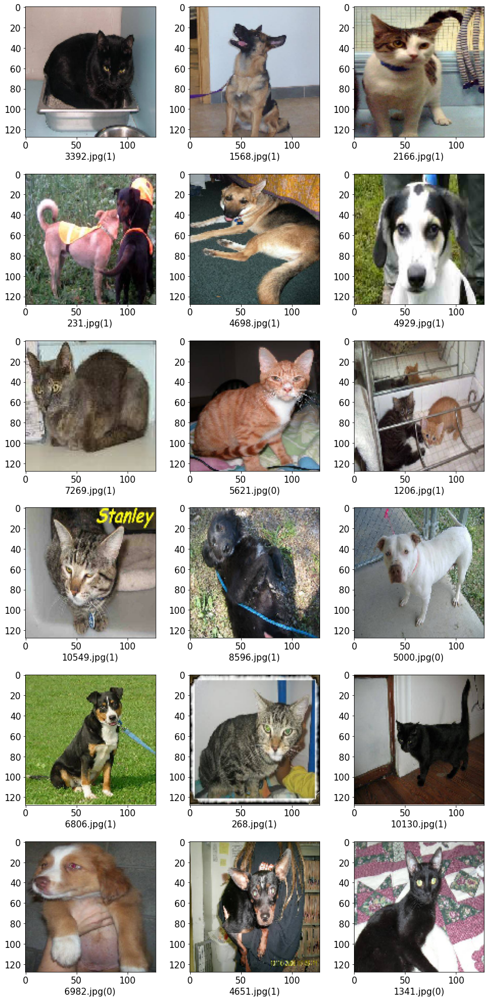

In [ ]:
from keras.preprocessing.image import load_img
sample_test = test_set.head(18)
sample_test.head()
plt.figure(figsize=(12, 24))
for index, row in sample_test.iterrows():
    filename = row['filenames']
    class_name = row['class']
    img = load_img("/content/test1/"+filename, target_size=(128,128))
    plt.subplot(6, 3, index+1)
    plt.imshow(img)
    plt.xlabel(filename + '(' + "{}".format(class_name) + ')' )
plt.tight_layout()
plt.show()